In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns
import matplotlib.pyplot as plt

In [2]:
pls=pd.read_csv("../../figures/7.spatial_architecture/Spatial_polygon_sample_1.csv")

In [3]:
sel='opt'


In [4]:
len(pls['tmp2[, c("ID")]'].unique())

36

/tmp/ipykernel_98/611992482.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


<Figure size 432x288 with 0 Axes>

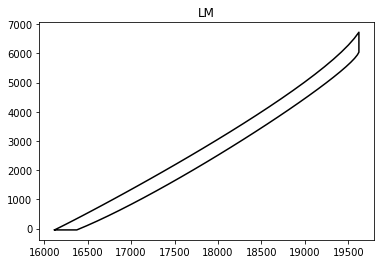

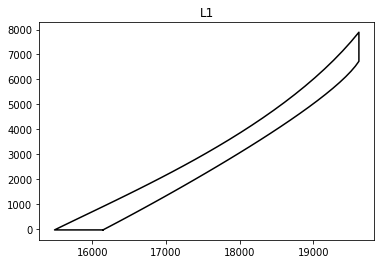

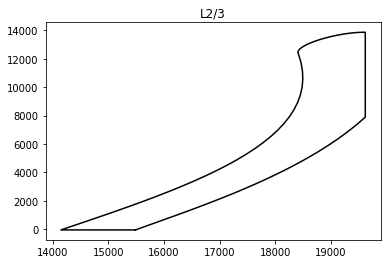

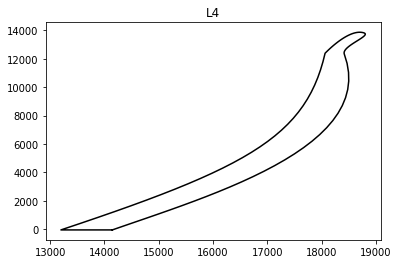

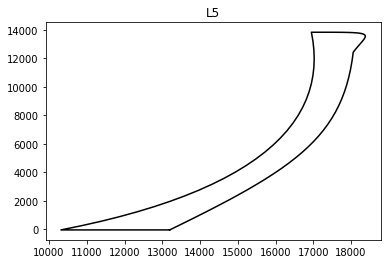

...

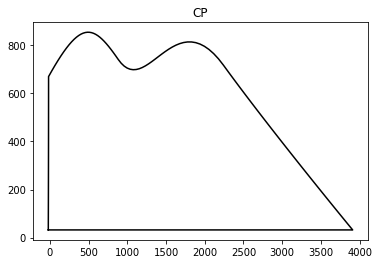

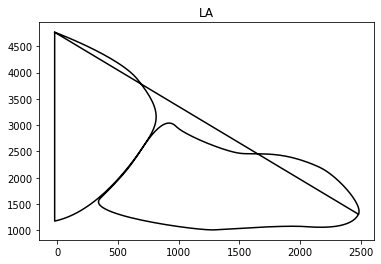

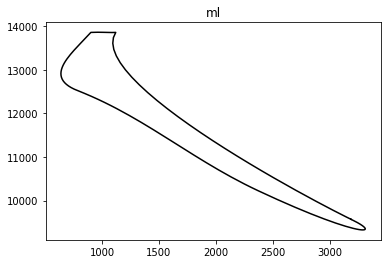

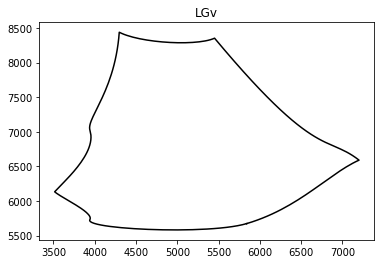

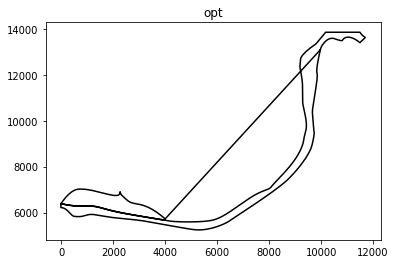

In [5]:
plt.figure()
for sel in pls['tmp2[, c("ID")]'].unique():
    plsub=pls[pls['tmp2[, c("ID")]']==sel]
    if plsub.shape[0]>2:
        coord = np.array(plsub[['y','x']]).tolist()
#        coord.append(coord[0])
        plt.figure()
        xs, ys = zip(*coord) #create lists of x and y values
        plt.plot(xs,ys,color='black') 
        plt.title(sel)
plt.show() # if you need...

In [6]:
banksy=pd.read_csv('../../figures/7.spatial_architecture/adata_obs_banksy_rep1.csv')

In [7]:
banksy['banksy']=banksy['clust_lam1_k50_res1.4']

In [8]:
banksy['banksy']=banksy['banksy'].astype('category')

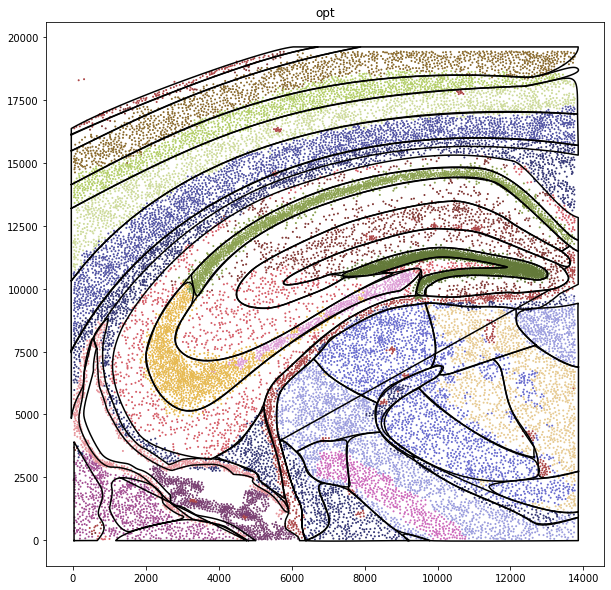

In [9]:
plt.figure(figsize=(10,10))
plt.scatter(banksy['x_centroid']/0.2125,banksy['y_centroid']/0.2125,s=1,c=banksy['banksy'],cmap='tab20b')
for sel in pls['tmp2[, c("ID")]'].unique():
    plsub=pls[pls['tmp2[, c("ID")]']==sel]
    if plsub.shape[0]>2:
        coord = np.array(plsub[['x','y']]).tolist()
#        coord.append(coord[0])
        xs, ys = zip(*coord) #create lists of x and y values
        plt.plot(xs,ys,color='black') 
        plt.title(sel)
plt.show() # if you need...

In [10]:
from shapely.geometry import Point
from shapely.geometry.polygon import Polygon

In [11]:
banksy['region']='None'

nan
LM
L1
L2/3
L4
L5
L6a
L6b
ec
sg
po
sp2/3
sp1
mo
sr
so
slm
APN
cpd
em
LP
VPL
VPLpc
PF
PO
int
LGd
ZI
fi
STN
RT
CP
LA
ml
LGv
opt


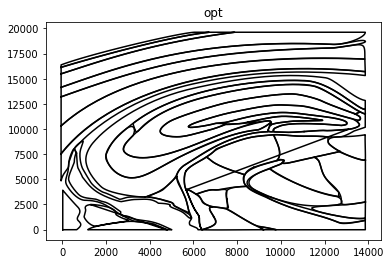

In [12]:
plt.figure()
for sel in pls['tmp2[, c("ID")]'].unique():
    print(sel)
    plsub=pls[pls['tmp2[, c("ID")]']==sel]
    if plsub.shape[0]>2:
        coord = np.array(plsub[['x','y']]).tolist()
        poly=Polygon(coord)
        for ind in banksy.index:
            if poly.contains(Point(banksy.loc[ind,['X','Y']]))==True:
                banksy.loc[ind,'region']=sel
#        coord.append(coord[0])
#  plt.figure()
        xs, ys = zip(*coord) #create lists of x and y values
        plt.plot(xs,ys,color='black') 
        plt.title(sel)
plt.show() # if you need...

In [13]:
# merge with SpaGCN

In [14]:
spagcn=sc.read('../../data/processed_adata/msbrain_spagcn_rep1.h5')

In [15]:
import sklearn.metrics as sk

In [32]:
spagcn.obs['spagcn_domains']=list(spagcn.obs['refined_pred'])

In [33]:
banksy_merged=pd.merge(banksy,spagcn.obs.loc[:,['cell_id','spagcn_domains']],on='cell_id')

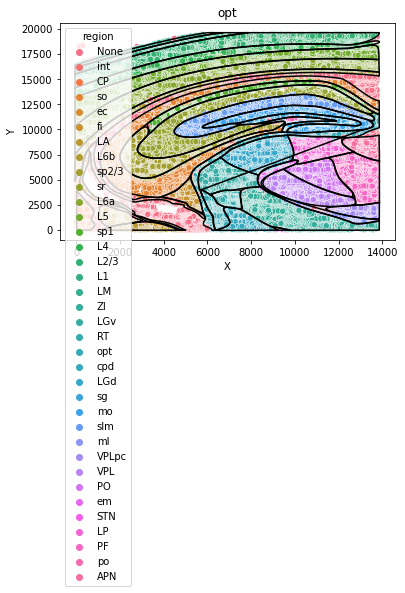

In [34]:
plt.figure()
for sel in pls['tmp2[, c("ID")]'].unique():
    plsub=pls[pls['tmp2[, c("ID")]']==sel]
    if plsub.shape[0]>2:
        coord = np.array(plsub[['x','y']]).tolist()
        poly=Polygon(coord)
        xs, ys = zip(*coord) #create lists of x and y values
        plt.plot(xs,ys,color='black') 
        plt.title(sel)
sns.scatterplot(data=banksy,x='X',y='Y',hue=banksy['region'])
plt.show() # if you need...

In [35]:
adataneigh=sc.read('../../figures/7.spatial_architecture/'+'/adata_msbrain_3rep_withclusters_neighbors_domains_rep1.h5ad')

In [36]:
cell_neigh=dict(zip(adataneigh.obs['cell_code'],adataneigh.obs['neighborhood_clusters']))

In [37]:
banksy_merged['neigh']=banksy_merged['cell_code'].map(cell_neigh)

# DeepST

In [38]:
deepST=sc.read('../../figures/7.spatial_architecture/deepst_adata_msbrain_rep1.h5')

In [39]:
cell_deepst=dict(zip(deepST.obs['cell_code'],deepST.obs['deepst']))

In [40]:
banksy_merged['deepst']=banksy_merged['cell_code'].map(cell_deepst)

In [41]:
columns_tested=['region','banksy','spagcn_domains','neigh','deepst']

In [42]:
banksy_merged2=banksy_merged[~banksy_merged['neigh'].isna()]

In [43]:
ARI=pd.DataFrame(index=columns_tested,columns=columns_tested)
for ind in ARI.index:
    for col in ARI.columns:
        ARI.loc[ind,col]=sk.adjusted_rand_score(banksy_merged2[ind],banksy_merged2[col])

In [90]:
ARI

,region,banksy,spagcn_domains,neigh,deepst
region,1.0,0.590939,0.366634,0.420684,0.540555
banksy,0.590939,1.0,0.428363,0.505598,0.705835
spagcn_domains,0.366634,0.428363,1.0,0.313912,0.450378
neigh,0.420684,0.505598,0.313912,1.0,0.525603
deepst,0.540555,0.705835,0.450378,0.525603,1.0


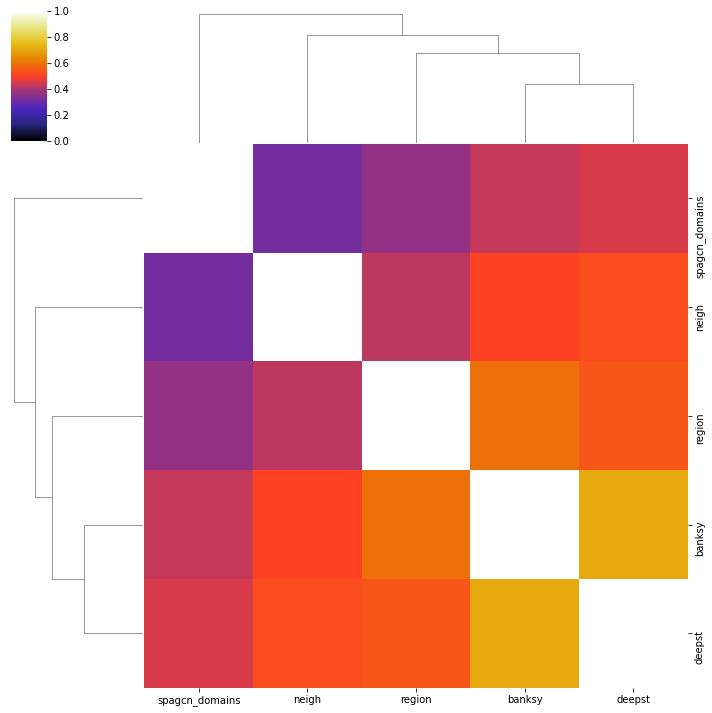

In [44]:
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
sns.clustermap(ARI.astype(float),vmin=0,vmax=1,cmap='CMRmap')
plt.savefig('../../figures/7.spatial_architecture/ari_between_domain_tools.pdf')
plt.show() # if you need...

In [45]:
domain_level=pd.read_csv("../../data/annotation_dictionaries/ABA_domain_annotation_dictionary.csv",sep=';')
domain_color_dict=dict(zip(domain_level['level5'],domain_level['color']))
banksy['domain_color']=banksy['region'].map(domain_color_dict)

In [46]:
banksy_merged['initial_annotation']

0         0_MFOL_NFOL
1            10_Astro
2         0_MFOL_NFOL
3         0_MFOL_NFOL
4        21_Ependymal
             ...     
25688     6_L6 CT CTX
25689    15_Microglia
25690         8_L5 IT
25691         8_L5 IT
25692     6_L6 CT CTX
Name: initial_annotation, Length: 25693, dtype: object

In [47]:
bd=banksy[~banksy['domain_color'].isna()]

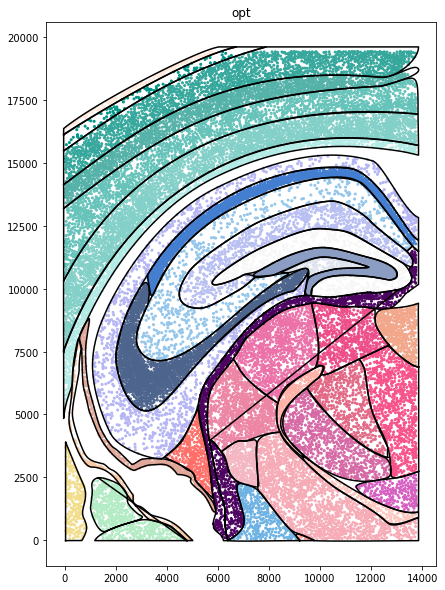

In [31]:
plt.figure(figsize=(7,10))
for sel in pls['tmp2[, c("ID")]'].unique():
    plsub=pls[pls['tmp2[, c("ID")]']==sel]
    if plsub.shape[0]>2:
        coord = np.array(plsub[['x','y']]).tolist()
        poly=Polygon(coord)
        xs, ys = zip(*coord) #create lists of x and y values
        plt.plot(xs,ys,color='black') 
        plt.title(sel)
plt.scatter(bd['X'],bd['Y'],color=bd['domain_color'],s=4)
plt.savefig('../../figures/7.spatial_architecture/annotated_domains.pdf')
plt.show() # if you need...

In [48]:
banksy_merged2['neigh']=banksy_merged2['neigh'].astype(int)

/tmp/ipykernel_98/3307402501.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  banksy_merged2['neigh']=banksy_merged2['neigh'].astype(int)


In [49]:
adataorig=sc.read('../../data/processed_adata/adata_msbrain_3rep_withclusters_only_nuclei_deep_annotation_with_colors.h5ad')

In [50]:
adataorig

AnnData object with n_obs × n_vars = 82941 × 284
    obs: 'ind', 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'graph_clusters', 'kmeans2_clusters', 'kmeans3_clusters', 'kmeans4_clusters', 'kmeans5_clusters', 'kmeans6_clusters', 'kmeans7_clusters', 'kmeans8_clusters', 'kmeans9_clusters', 'kmeans10_clusters', 'replicate', 'n_counts', 'leiden_2_2', 'leiden_1_8', 'leiden_1_4', 'leiden_1_0', 'leiden_0_8', 'leiden_0_6', 'cell_code', 'expanded_class', 'expanded_initial_annotation', 'Class', 'initial_annotation', 'celltype_annotation', 'X', 'Y', 'leiden_0_4', 'leiden_0_2', 'Class_old', 'class_number'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'Class_colors', 'celltype_annotation_colors', 'dendrogram_celltype_annotation', 'dendrogram_initial_annotation', 'expanded_class_colors', 'expanded_initial_annotation_colors', 'hvg', 'initial_annotation_colors

In [51]:
cls=adataorig.uns['celltype_annotation_colors']

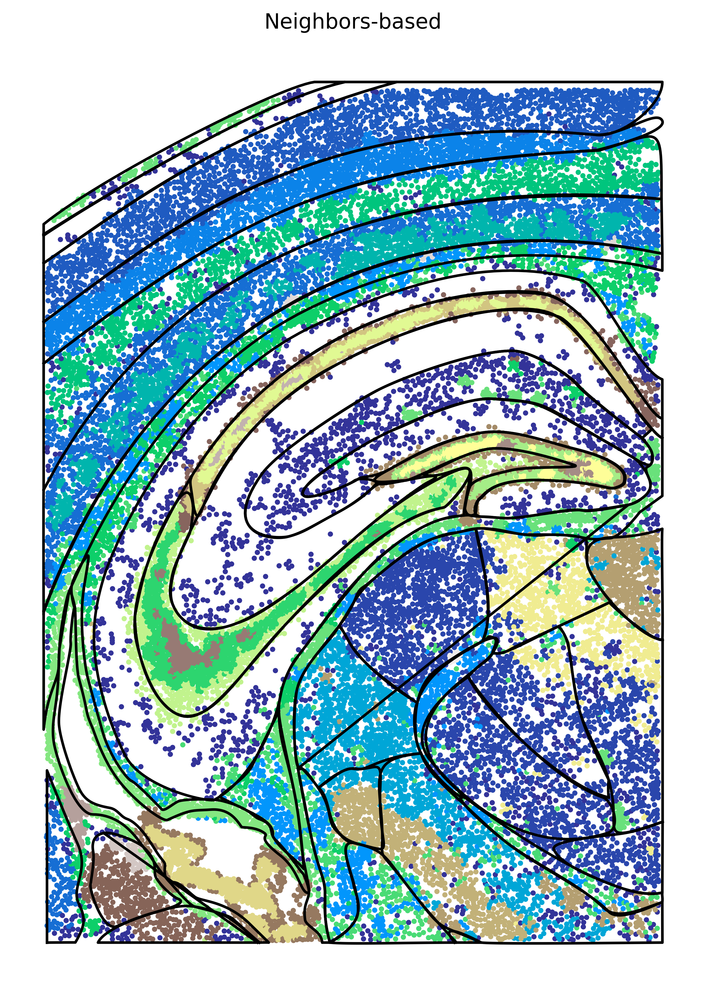

In [69]:
plt.figure(figsize=(7,10),dpi=500)
for sel in pls['tmp2[, c("ID")]'].unique():
    plsub=pls[pls['tmp2[, c("ID")]']==sel]
    if plsub.shape[0]>2:
        coord = np.array(plsub[['x','y']]).tolist()
        poly=Polygon(coord)
        xs, ys = zip(*coord) #create lists of x and y values
        plt.plot(xs,ys,color='black') 
        plt.title(sel)
plt.scatter(banksy_merged2['X'],banksy_merged2['Y'],c=banksy_merged2['neigh'],s=4,cmap='terrain')
plt.title('Neighbors-based')
plt.axis('off')
plt.savefig('../../figures/7.spatial_architecture/domains_neighbors.tif')
plt.show() # if you need...

/tmp/ipykernel_49/1039882341.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  banksy_merged2['deepst']=banksy_merged2['deepst'].astype(int)


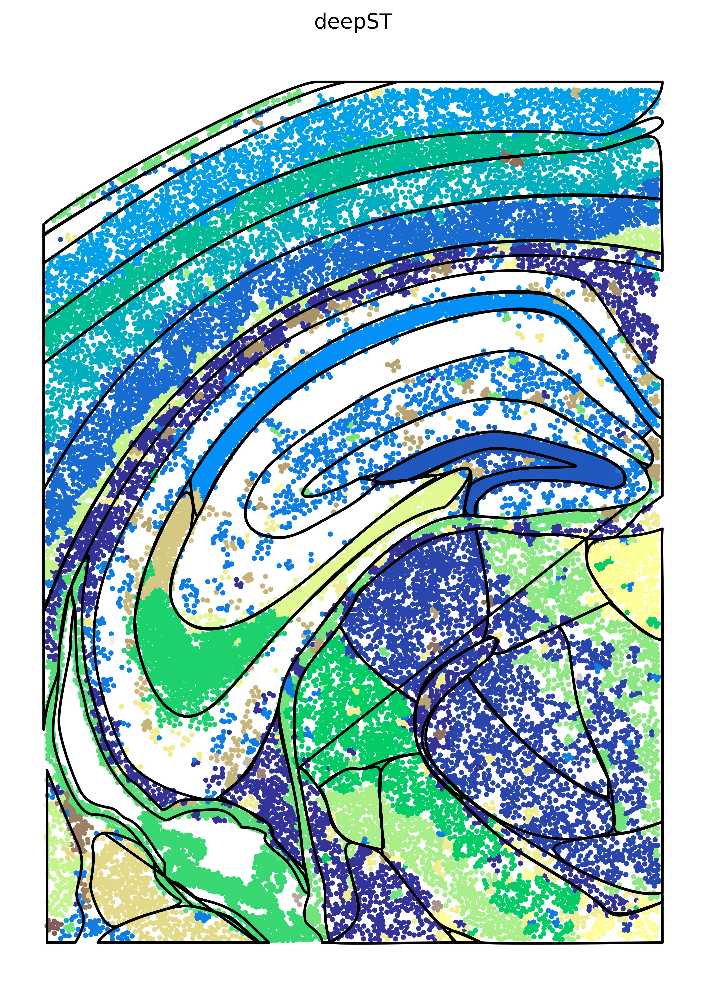

In [68]:
banksy_merged2['deepst']=banksy_merged2['deepst'].astype(int)
plt.figure(figsize=(7,10),dpi=500)
for sel in pls['tmp2[, c("ID")]'].unique():
    plsub=pls[pls['tmp2[, c("ID")]']==sel]
    if plsub.shape[0]>2:
        coord = np.array(plsub[['x','y']]).tolist()
        poly=Polygon(coord)
        xs, ys = zip(*coord) #create lists of x and y values
        plt.plot(xs,ys,color='black') 
        plt.title(sel)
plt.scatter(banksy_merged2['X'],banksy_merged2['Y'],c=banksy_merged2['deepst'],s=4,cmap='terrain')
plt.title('deepST')
plt.axis('off')
plt.savefig('../../figures/7.spatial_architecture/domains_deepst.tif')
plt.show() # if you need...

/tmp/ipykernel_49/743539635.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  banksy_merged2['deepst']=banksy_merged2['deepst'].astype(int)


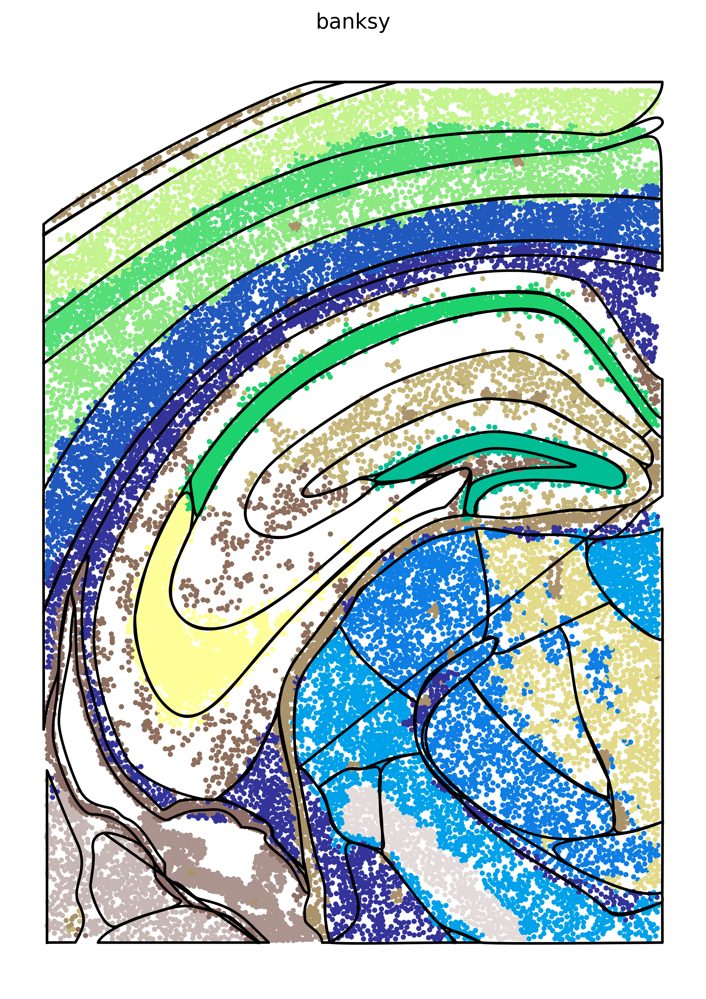

In [67]:
banksy_merged2['deepst']=banksy_merged2['deepst'].astype(int)
plt.figure(figsize=(7,10),dpi=500)
for sel in pls['tmp2[, c("ID")]'].unique():
    plsub=pls[pls['tmp2[, c("ID")]']==sel]
    if plsub.shape[0]>2:
        coord = np.array(plsub[['x','y']]).tolist()
        poly=Polygon(coord)
        xs, ys = zip(*coord) #create lists of x and y values
        plt.plot(xs,ys,color='black') 
        plt.title(sel)
plt.scatter(banksy_merged2['X'],banksy_merged2['Y'],c=banksy_merged2['banksy'],s=4,cmap='terrain')
plt.title('banksy')
plt.axis('off')
plt.savefig('../../figures/7.spatial_architecture/domains_banksy.tif')
plt.show() # if you need...

/tmp/ipykernel_98/1975004072.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  banksy_merged2['deepst']=banksy_merged2['deepst'].astype(int)


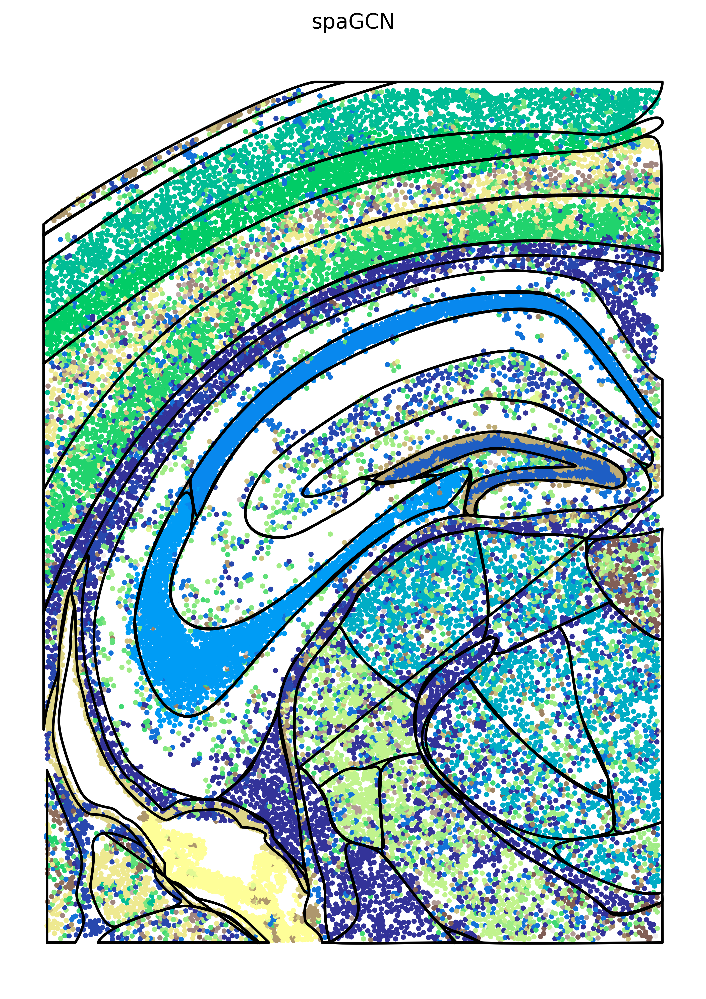

In [53]:
banksy_merged2['deepst']=banksy_merged2['deepst'].astype(int)
plt.figure(figsize=(7,10),dpi=500)
for sel in pls['tmp2[, c("ID")]'].unique():
    plsub=pls[pls['tmp2[, c("ID")]']==sel]
    if plsub.shape[0]>2:
        coord = np.array(plsub[['x','y']]).tolist()
        poly=Polygon(coord)
        xs, ys = zip(*coord) #create lists of x and y values
        plt.plot(xs,ys,color='black') 
        plt.title(sel)
plt.scatter(banksy_merged2['X'],banksy_merged2['Y'],c=banksy_merged2['spagcn_domains'],s=4,cmap='terrain')
plt.title('spaGCN')
plt.axis('off')
plt.savefig('../../figures/7.spatial_architecture/domains_spagcn.tif')
plt.show() # if you need...

In [54]:
adataorig=sc.read('../../data/processed_adata/adata_msbrain_3rep_withclusters_only_nuclei_deep_annotation_with_domains.h5ad')

In [55]:
adata1=adataorig[adataorig.obs['replicate']=='1']

In [56]:
exp_rep1=pd.DataFrame(adata1.X.todense(),columns=adata1.var.index)

In [57]:
exp_rep1['region_annotation']=list(adata1.obs['region_annotation'])

In [58]:
mean_expression=exp_rep1.groupby('region_annotation').mean()

In [59]:
import pandas as pd
from matplotlib import pyplot as plt
from scipy.cluster.hierarchy import dendrogram, linkage

In [60]:
mean_expression=mean_expression.div(mean_expression.sum(axis=0),axis=1)

In [61]:
Z = linkage(mean_expression, 'ward')

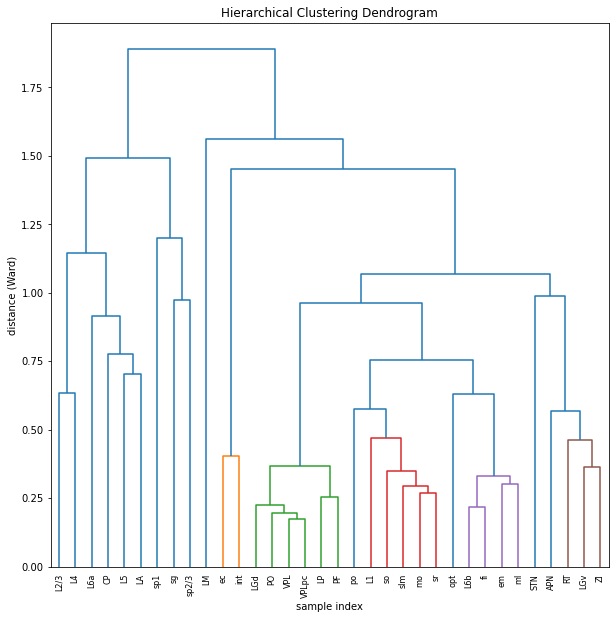

In [62]:
plt.figure(figsize=(10,10))
plt.title('Hierarchical Clustering Dendrogram')

# Plot axis labels
plt.xlabel('sample index')
plt.ylabel('distance (Ward)')

# Make the dendrogram
dendrogram(Z, labels=mean_expression.index, leaf_rotation=90,color_threshold=0.5)

# Show the graph
plt.show()

In [63]:
results=pd.DataFrame(index=banksy_merged2['region'].unique(),columns=banksy_merged2['banksy'].unique())

In [64]:
import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns
import matplotlib.pyplot as plt
import sklearn.metrics as sm 

In [65]:
s=0
for cl1 in results.index:
    for cl2 in results.columns:
        s=s+1
        print(s)
        readsel=banksy_merged2[(banksy_merged2['region']==cl1)+(banksy_merged2['banksy']==cl2)]
        val=sm.jaccard_score(list((readsel['region']==cl1)*1),list((readsel['banksy']==cl2)*1),average='binary')
        results.loc[cl1,cl2]=val

1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
277


In [66]:
jsc=pd.DataFrame(np.max(results,axis=1),columns=['banksy'])

In [67]:
results=pd.DataFrame(index=banksy_merged2['region'].unique(),columns=banksy_merged2['deepst'].unique())
s=0
for cl1 in results.index:
    for cl2 in results.columns:
        s=s+1
        print(s)
        readsel=banksy_merged2[(banksy_merged2['region']==cl1)+(banksy_merged2['deepst']==cl2)]
        val=sm.jaccard_score(list((readsel['region']==cl1)*1),list((readsel['deepst']==cl2)*1),average='binary')
        results.loc[cl1,cl2]=val
jsc['deepst']=list(np.max(results,axis=1))

1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
277


In [68]:
results=pd.DataFrame(index=banksy_merged2['region'].unique(),columns=banksy_merged2['neigh'].unique())
s=0
for cl1 in results.index:
    for cl2 in results.columns:
        s=s+1
        print(s)
        readsel=banksy_merged2[(banksy_merged2['region']==cl1)+(banksy_merged2['neigh']==cl2)]
        val=sm.jaccard_score(list((readsel['region']==cl1)*1),list((readsel['neigh']==cl2)*1),average='binary')
        results.loc[cl1,cl2]=val
jsc['neigh']=list(np.max(results,axis=1))

1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
277


In [69]:
results=pd.DataFrame(index=banksy_merged2['region'].unique(),columns=banksy_merged2['spagcn_domains'].unique())
s=0
for cl1 in results.index:
    for cl2 in results.columns:
        s=s+1
        print(s)
        readsel=banksy_merged2[(banksy_merged2['region']==cl1)+(banksy_merged2['spagcn_domains']==cl2)]
        val=sm.jaccard_score(list((readsel['region']==cl1)*1),list((readsel['spagcn_domains']==cl2)*1),average='binary')
        results.loc[cl1,cl2]=val
jsc['spagcn_domains']=list(np.max(results,axis=1))

1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
277


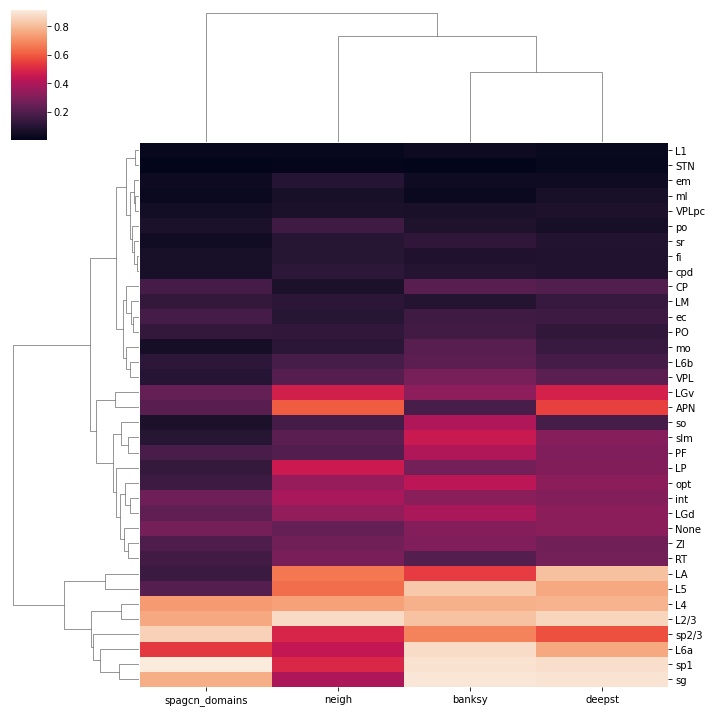

In [70]:
sns.clustermap(jsc)

In [71]:
Z

array([[17.        , 18.        ,  0.17486383,  2.        ],
       [14.        , 34.        ,  0.19671184,  3.        ],
       [ 7.        , 22.        ,  0.21569812,  2.        ],
       [ 9.        , 35.        ,  0.22338671,  4.        ],
       [12.        , 13.        ,  0.25285371,  2.        ],
       [25.        , 33.        ,  0.26932238,  2.        ],
       [29.        , 39.        ,  0.29396889,  3.        ],
       [21.        , 24.        ,  0.30041232,  2.        ],
       [36.        , 41.        ,  0.33002189,  4.        ],
       [30.        , 40.        ,  0.34809256,  4.        ],
       [10.        , 19.        ,  0.36347132,  2.        ],
       [37.        , 38.        ,  0.36669268,  6.        ],
       [20.        , 23.        ,  0.4030635 ,  2.        ],
       [15.        , 44.        ,  0.461411  ,  3.        ],
       [ 2.        , 43.        ,  0.4694462 ,  5.        ],
       [ 0.        , 47.        ,  0.56719459,  4.        ],
       [27.        , 48.

In [72]:
corr=pd.DataFrame(index=mean_expression.index,columns=mean_expression.index)
for ind in corr.index:
    for col in corr.columns:
        if ind!=col:
            corr.loc[ind,col]=np.corrcoef(mean_expression.loc[ind,:],mean_expression.loc[col,:])[0,1]
        else:
            corr.loc[ind,col]=0

In [73]:
similarity=pd.DataFrame(np.mean(corr,axis=1))

In [74]:
results=jsc.join(similarity)
results['max_correlation']=results[0]

In [75]:
valuesdict=dict(zip(jsc.index,np.mean(jsc,axis=1)))

In [76]:
bd['agreement']=bd['region'].map(valuesdict)

/tmp/ipykernel_98/1046169470.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  bd['agreement']=bd['region'].map(valuesdict)


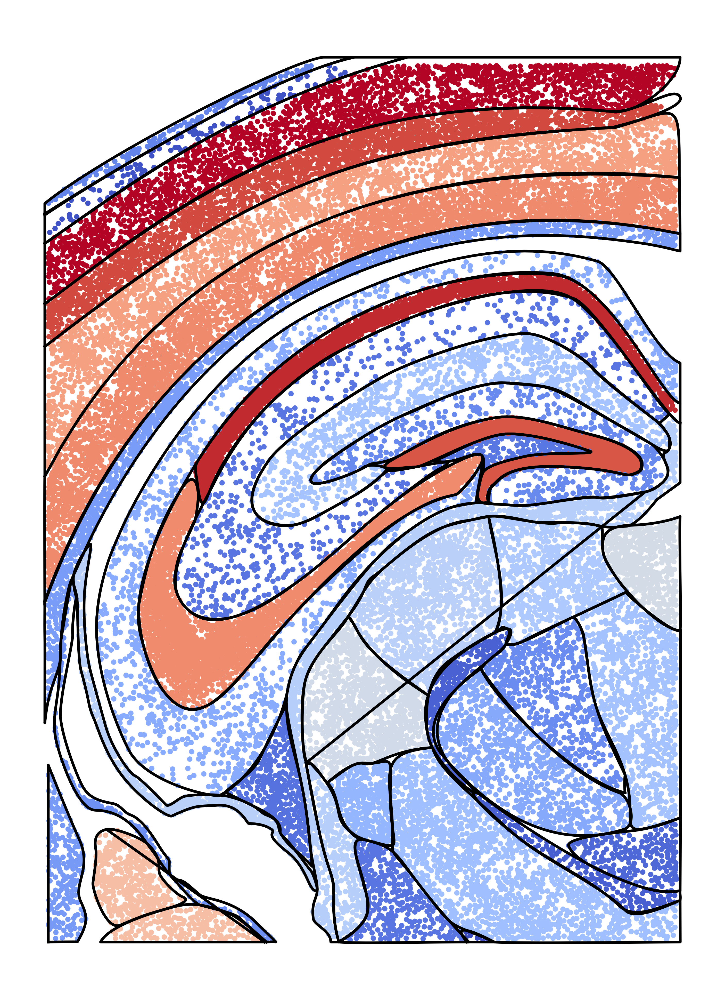

In [89]:
plt.figure(figsize=(7,10),dpi=500)
for sel in pls['tmp2[, c("ID")]'].unique():
    plsub=pls[pls['tmp2[, c("ID")]']==sel]
    if plsub.shape[0]>2:
        coord = np.array(plsub[['x','y']]).tolist()
        poly=Polygon(coord)
        xs, ys = zip(*coord) #create lists of x and y values
        plt.plot(xs,ys,color='black') 
#        plt.title(sel)
plt.axis('off')
#plt.title('accuracy')
plt.scatter(bd['X'],bd['Y'],c=bd['agreement'],s=4,cmap='coolwarm')
plt.savefig('../../figures/7.spatial_architecture/annotated_domains_colored_by_prediction_accuracy_rdbu.tif')
plt.show() # if you need...

In [78]:
results['average']=np.mean(results.iloc[:,0:4],axis=1)
results=results.sort_values(by='average',ascending=True)

In [79]:
#results=results.iloc[1:,:]
results=results.fillna(0)
results=results[~results.index.isin(['None'])]

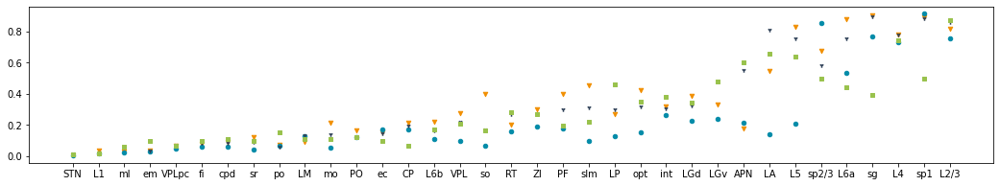

In [88]:
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
plt.figure(figsize=(18,3))
plt.scatter(results.index,results['banksy'],s=20,c='#F18F01',marker='v')
plt.scatter(results.index,results['spagcn_domains'],s=20,c='#048BA8',marker='o')
plt.scatter(results.index,results['deepst'],s=20,c='#2E4057',marker='1')
plt.scatter(results.index,results['neigh'],s=20,c='#99C24D',marker='s')
plt.savefig('../../figures/7.spatial_architecture/jaccard_max_by_domain.pdf')

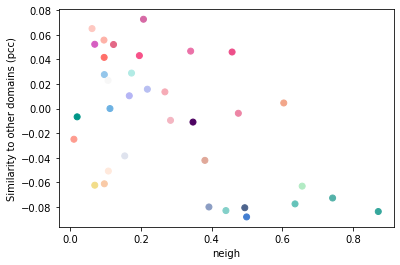

In [110]:
plt.scatter(results['neigh'],results['max_correlation'],c=results.index.map(domain_color_dict))
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
plt.xlabel('neigh')
plt.ylabel('Similarity to other domains (pcc)')
plt.savefig('../../figures/7.spatial_architecture/neigh_jaccard_vs_corr.pdf')

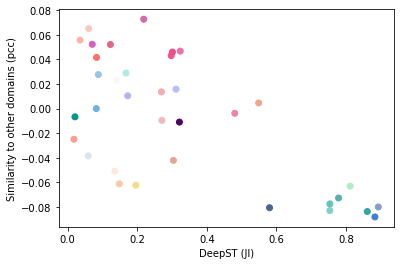

In [111]:
plt.scatter(results['deepst'],results['max_correlation'],c=results.index.map(domain_color_dict))
plt.xlabel('DeepST (JI)')
plt.ylabel('Similarity to other domains (pcc)')
plt.savefig('../../figures/7.spatial_architecture/deepst_jaccard_vs_corr.pdf')

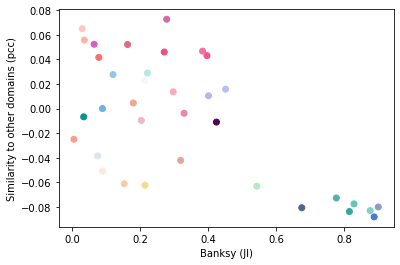

In [112]:
plt.scatter(results['banksy'],results['max_correlation'],c=results.index.map(domain_color_dict))
plt.xlabel('Banksy (JI)')
plt.ylabel('Similarity to other domains (pcc)')
plt.savefig('../../figures/7.spatial_architecture/banksy_jaccard_vs_corr.pdf')

In [ ]:
plt.scatter(results['banksy'],results['max_correlation'],c=results.index.map(domain_color_dict))
plt.xlabel('Banksy (JI)')
plt.ylabel('Similarity to other domains (pcc)')
plt.savefig('../../figures/7.spatial_architecture/banksy_jaccard_vs_corr.pdf')

In [237]:
results=results.iloc[1:,:]
results=results.fillna(0)

In [242]:
np.corrcoef(results['deepst'],results['max_correlation'])[0,1]

-0.6770800764570911